# Introduction
In this post, we're going to take a look at visualising PXRD patterns in a somewhat unusual way. We are going to generate a whole load of random unit cells, and from these, calculate the peak positions we would expect to see in $Cu_{K\alpha_1}$ PXRD data. We will treat these peak positions as coordinates in a high-dimensional space, and we will then apply various dimensionality reduction techniques to the peak position vectors and visualise the results.

This exercise provides some interesting results, particularly when we think about how PXRD data can be classified into the correct [crystal system](https://journals.iucr.org/m/issues/2017/04/00/fc5018/index.html), [extinction class](https://journals.iucr.org/m/issues/2017/04/00/fc5018/index.html) or [space group](https://www.sciencedirect.com/science/article/abs/pii/S2352492820326738) by neural networks (the linked articles generally set out to tackle more than one of these classification tasks).

In part 2 of this work, we will apply the same kind of techniques to full diffraction histograms.

Some of the methods we'll be using, such as Principal Component Analysis (PCA) and Multi-dimensional Scaling (MDS) have previously been used in the crystallographic context in the program PolySNAP (and its successors). See the chapter by [Gilmore, Barr and Dong](https://onlinelibrary.wiley.com/iucr/itc/Ha/ch3o8v0001/) in International Tables volume H for more information.

In [1]:
import numpy as np
import matplotlib.pyplot as plt
import pymatgen as pmg

In [136]:
def get_unit_cell_dimensions(n_cells, minlength=5, maxlength=15, minangle=80,
                            maxangle=120, crystalsystem="triclinic"):
    lengths = np.random.uniform(minlength,maxlength,(n_cells,3))
    angles = np.random.uniform(minangle, maxangle, (n_cells,3))
    angles_radians = np.radians(angles)
    if crystalsystem.lower() != "triclinic":
        if crystalsystem.lower() == "monoclinic":
            angles_radians[:,0] = np.pi/2
            angles_radians[:,2] = np.pi/2
        elif crystalsystem.lower() == "hexagonal":
            angles_radians[:,0] = np.pi/2
            angles_radians[:,1] = np.pi/2
            angles_radians[:,2] = 2*np.pi/3
            lengths[:,1] = lengths[:,0].copy()
        else: # Orthorhombic, tetragonal, cubic
            angles_radians[:,0] = np.pi/2
            angles_radians[:,1] = np.pi/2
            angles_radians[:,2] = np.pi/2
            if crystalsystem.lower() == "tetragonal":
                lengths[:,1] = lengths[:,0].copy()
            elif crystalsystem.lower() == "cubic":
                lengths[:,1] = lengths[:,0].copy()
                lengths[:,2] = lengths[:,0].copy()
    cells = np.hstack([lengths, angles_radians])
    return cells

In [137]:
def get_lattice_matrix(unit_cell_dimensions):
    a, b, c = unit_cell_dimensions[:,:3].T
    cosal, cosbe, cosga = np.cos(unit_cell_dimensions[:,3:]).T
    sinal, sinbe, singa = np.sin(unit_cell_dimensions[:,3:]).T
    # Sometimes rounding errors result in values slightly > 1.
    val = np.clip((cosal * cosbe - cosga) / (sinal * sinbe), a_min=-1, a_max=1)

    gamma_star = np.arccos(val)
    zeros = np.zeros_like(c)
    v_a = np.stack([a * sinbe, zeros, a*cosbe]).T
    v_b = np.stack([-b * sinal * np.cos(gamma_star), b*sinal * np.sin(gamma_star), b*cosal]).T
    v_c = np.stack([zeros, zeros, c]).T

    #matrix = np.swapaxes(np.stack([v_a,v_b,v_c], axis=2),1,2)
    matrix = np.stack([v_a,v_b,v_c], axis=2)
    """insideroot = 1.0-cosal**2-cosbe**2-cosga**2+2*cosal*cosbe*cosga
    # If this term is less than one, we have an invalid cell, so get rid of them
    matrix = matrix[insideroot > 0]
    insideroot = insideroot[insideroot > 0]

    volume = a*b*c*np.sqrt(insideroot)
    if insideroot.shape[0] != unit_cell_dimensions.shape[0]:
        print(f"{unit_cell_dimensions.shape[0]-insideroot.shape[0]} invalid cells removed")"""
    volume = np.abs(np.linalg.det(matrix))
    return matrix, volume

def get_recip_lattice_matrix(matrix):
    return np.linalg.inv(matrix)

def get_recip_lattice_metric_tensor(recip_lattice_matrix):
    return recip_lattice_matrix @ np.swapaxes(recip_lattice_matrix,1,2)

def get_d_spacing(inv_metric_tensor,hkl,lam):
    one_over_d_squared = np.einsum("ij,bji->bi",hkl,np.einsum("bij,kj->bik",inv_metric_tensor,hkl))
    # Errors sometimes arise which lead to negative values being found here. This results from invalid cells
    # and so these results should be removed.
    valid = (one_over_d_squared <= 0).sum(axis=1) == 0
    print(f"{100.*valid.sum()/valid.shape[0]} % valid cells")
    d = 1/np.sqrt(one_over_d_squared[valid])
    # Any d-spacings that are not accessible with the wavelength used should be removed
    # Set their value such that lam/2d = 1 and hence the inverse sin will put their two-theta to 180
    # And so they won't be included in the peaks
    too_small = 2*d < lam
    d[too_small] = lam/2
    return d, valid, too_small

def d_to_tt(d,lam,too_small):
    tt = (180/np.pi)*2*np.arcsin(lam/(2*d))
    tt[too_small] = -1
    return tt

def tt_to_d(tt,lam):
    return lam/(2*np.sin(tt/2))

In [138]:
h,k,l = np.meshgrid(np.arange(-10,11),np.arange(-10,11),np.arange(-10,11))
hkl = np.vstack([h.ravel(), k.ravel(), l.ravel()]).T
# Remove [0,0,0] reflection
hkl = hkl[np.abs(hkl).sum(axis=1)>0]
print(hkl.shape)

(9260, 3)


In [139]:
all_systems = []
crystal_system = []
cells = []
volumes = []
systems = ["triclinic","monoclinic","orthorhombic", "tetragonal", "hexagonal", "cubic"]
#systems = ["orthorhombic", "tetragonal", "hexagonal", "cubic"]
nsamples = 10000

for i, cs in enumerate(systems):
    unit_cell_dimensions = get_unit_cell_dimensions(nsamples,crystalsystem=cs, maxlength=15)
    lattice_matrix, volume = get_lattice_matrix(unit_cell_dimensions)
    recip_lattice_matrix = get_recip_lattice_matrix(lattice_matrix)
    recip_lattice_metric_tensor = get_recip_lattice_metric_tensor(recip_lattice_matrix)
    lam = 1.54056
    d, valid, too_small = get_d_spacing(recip_lattice_metric_tensor,hkl,lam)
    tt = d_to_tt(d, lam, too_small)
    cells.append(unit_cell_dimensions[valid])
    volumes.append(volume[valid])
    all_systems.append(tt)
    crystal_system.append(i*np.ones(valid.sum()))
all_systems = np.vstack(all_systems)
crystal_system = np.hstack(crystal_system)

100.0 % valid cells
100.0 % valid cells
100.0 % valid cells
100.0 % valid cells
100.0 % valid cells
100.0 % valid cells


In [140]:
first_thirty = []
for t in all_systems:
    t = np.unique(np.around(t[t>0],6))
    if t[:20].max() < 180:
        first_thirty.append(t[:20])
first_thirty = np.array(first_thirty)
print(first_thirty.shape)

(60000, 20)


In [141]:
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split

random_state = 42
X_train, X_test, y_train, y_test = train_test_split(first_thirty, crystal_system, random_state=random_state, shuffle=True, test_size=10000)

cells = np.vstack(cells)
volumes = np.hstack(volumes)

cells_train, cells_test, volumes_train, volumes_test = train_test_split(cells, volumes, test_size=y_test.shape[0], random_state=random_state)

In [142]:
scaler = StandardScaler()
pca = PCA(whiten=True)
scaled = scaler.fit_transform(X_train)
pca_transformed = pca.fit_transform(scaled)

In [143]:
print(100*pca.explained_variance_ratio_[:6])
print(100*pca.explained_variance_ratio_[:6].sum())

[96.46106456  1.78775745  0.89243086  0.32297124  0.14053371  0.11970709]
99.72446489921656


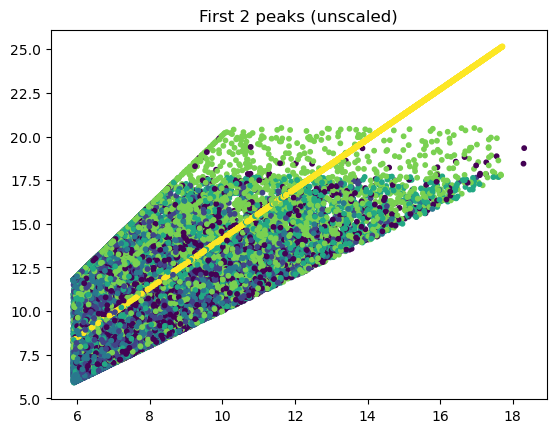

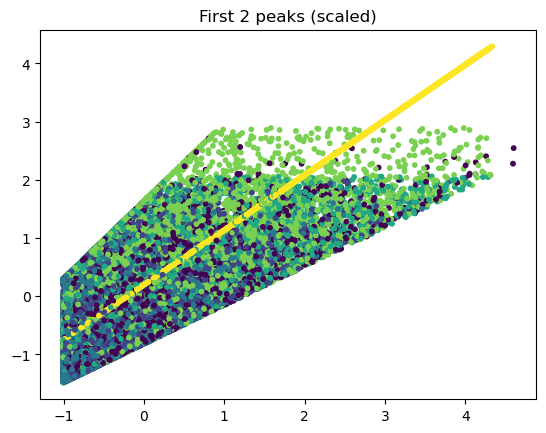

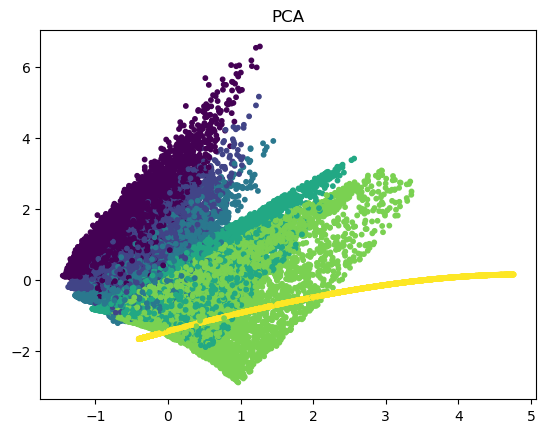

In [144]:
plt.scatter(X_train[:,0], X_train[:,1], s=10, c=y_train)
plt.title("First 2 peaks (unscaled)")
plt.show()
plt.scatter(scaled[:,0], scaled[:,1], s=10, c=y_train)
plt.title("First 2 peaks (scaled)")
plt.show()
plt.scatter(pca_transformed[:,0],pca_transformed[:,1], s=10, c=y_train)
plt.title("PCA")
plt.show()

In [150]:
from umap import UMAP
u = UMAP(n_neighbors=50, metric="manhattan", min_dist=0.)
umap_transformed = u.fit_transform(scaled)

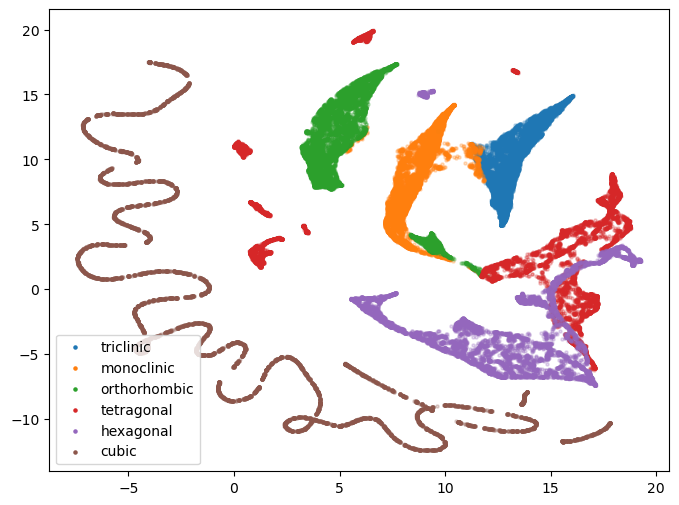

In [151]:
plt.figure(figsize=(8,6))
for i, cs in enumerate(systems):
    plt.scatter(umap_transformed[:,0][y_train == i],umap_transformed[:,1][y_train == i],s=5,alpha=0.25)
leg = plt.legend(systems)
for lh in leg.legend_handles:
    lh.set_alpha(1)
plt.show()


In [147]:
u_with_labels = UMAP(n_neighbors=50)
umap_transformed_with_labels = u_with_labels.fit_transform(scaled, y_train)

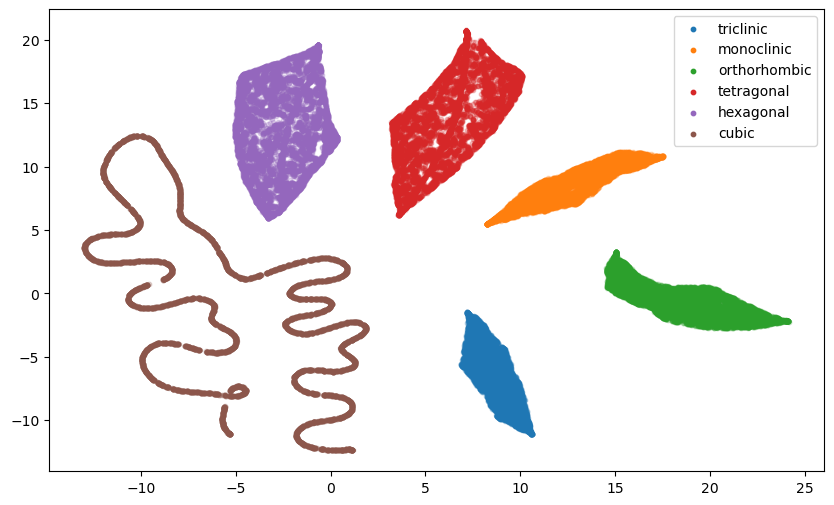

In [148]:
plt.figure(figsize=(10,6))
for i, cs in enumerate(systems):
    plt.scatter(umap_transformed_with_labels[:,0][y_train == i],umap_transformed_with_labels[:,1][y_train == i],s=10,alpha=0.25)
leg = plt.legend(systems)
for lh in leg.legend_handles:
    lh.set_alpha(1)
plt.show()

In [149]:
from openTSNE import TSNE

t_SNE = TSNE(n_components=2, n_jobs=16)
tsne_transformed = t_SNE.fit(scaled)

KeyboardInterrupt: 

Exception ignored in: 'openTSNE._matrix_mul.matrix_mul.matrix_multiply_fft_2d'
Traceback (most recent call last):
  File "<__array_function__ internals>", line 200, in rfft2
  File "c:\Users\Mark\.conda\envs\testgallop\lib\site-packages\numpy\fft\_pocketfft.py", line 1257, in rfft2
    return rfftn(a, s, axes, norm)
  File "<__array_function__ internals>", line 200, in rfftn
  File "c:\Users\Mark\.conda\envs\testgallop\lib\site-packages\numpy\fft\_pocketfft.py", line 1202, in rfftn
    a = rfft(a, s[-1], axes[-1], norm)
  File "<__array_function__ internals>", line 200, in rfft
  File "c:\Users\Mark\.conda\envs\testgallop\lib\site-packages\numpy\fft\_pocketfft.py", line 409, in rfft
    output = _raw_fft(a, n, axis, True, True, inv_norm)
  File "c:\Users\Mark\.conda\envs\testgallop\lib\site-packages\numpy\fft\_pocketfft.py", line 70, in _raw_fft
    r = pfi.execute(a, is_real, is_forward, fct)
KeyboardInterrupt: 


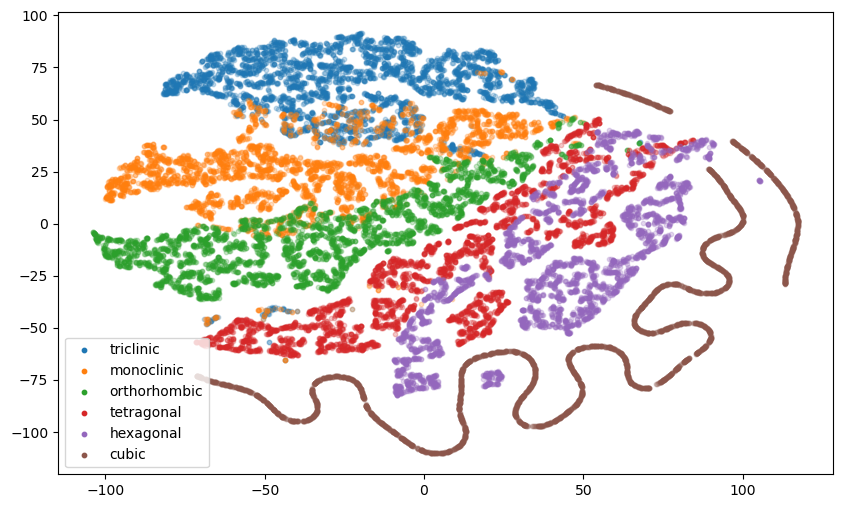

In [ ]:
plt.figure(figsize=(10,6))
for i, cs in enumerate(systems):
    plt.scatter(tsne_transformed[:,0][y_train == i],tsne_transformed[:,1][y_train == i],s=10,alpha=0.25)
leg = plt.legend(systems)
for lh in leg.legend_handles:
    lh.set_alpha(1)
plt.show()

In [ ]:
t_SNE3d = TSNE(n_components=3, n_jobs=16,negative_gradient_method="bh")
tsne3d_transformed = t_SNE3d.fit(scaled)

In [152]:
u3d = UMAP(n_components=3)
u3d_with_labels = UMAP(n_components=3, n_neighbors=50, metric="manhattan", min_dist=0.0)
umap3d_transformed = u3d.fit_transform(scaled)
umap3d_transformed_with_labels = u3d_with_labels.fit_transform(scaled, y_train)

In [153]:
import pandas as pd
import plotly.express as px

In [154]:
import pandas as pd
import plotly.express as px
df = pd.DataFrame()
data = umap3d_transformed
df["x"] = data[:,0]
df["y"] = data[:,1]
df["z"] = data[:,2]
df["a"] =  np.around(cells_train[:,0], 2)
df["b"] =  np.around(cells_train[:,1], 2)
df["c"] =  np.around(cells_train[:,2], 2)
df["al"] = np.around(np.degrees(cells_train[:,3]), 2)
df["be"] = np.around(np.degrees(cells_train[:,4]), 2)
df["ga"] = np.around(np.degrees(cells_train[:,5]), 2)
df["volume"] = np.around(volumes_train,2)
df["cs"] = y_train
csdict = {}
for i,x in enumerate(systems):
    csdict[i] = x
df["crystal_system"] = df["cs"].map(csdict)

In [155]:
fig = px.scatter_3d(df, x="x", y="y", z="z", color="crystal_system",size="volume",size_max=20,opacity=1,hover_data=["a","b","c","al","be","ga","volume","crystal_system"])
fig.update_layout(margin=dict(l=0, r=0, b=0, t=0))
fig.show()

In [ ]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import confusion_matrix, classification_report, ConfusionMatrixDisplay


clf = RandomForestClassifier(n_estimators=100)
clf.fit(X_train, y_train)
predicted = clf.predict(X_test)


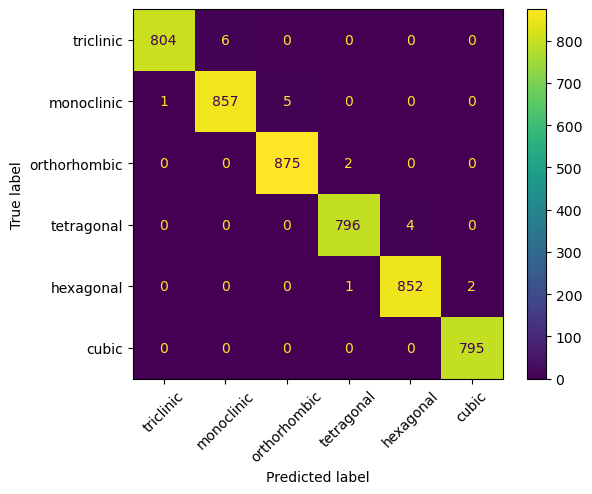

In [ ]:
cm = confusion_matrix(y_test, predicted)
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=systems)
disp.plot()
plt.xticks(rotation=45)
plt.show()

In [ ]:
cr = classification_report(y_test, predicted)
print(cr)

              precision    recall  f1-score   support

         0.0       1.00      0.99      1.00       810
         1.0       0.99      0.99      0.99       863
         2.0       0.99      1.00      1.00       877
         3.0       1.00      0.99      1.00       800
         4.0       1.00      1.00      1.00       855
         5.0       1.00      1.00      1.00       795

    accuracy                           1.00      5000
   macro avg       1.00      1.00      1.00      5000
weighted avg       1.00      1.00      1.00      5000



In [ ]:
n_imp = 2
impure_patterns = []
for pattern in X_test:
    imp_peaks = np.random.uniform(pattern.min(), pattern.max(), 2)
    new_pattern = np.sort(pattern.tolist()+imp_peaks.tolist())
    impure_patterns.append(new_pattern[:30])
impure_patterns = np.array(impure_patterns)

In [ ]:
tsne3d_transformed_impure = tsne3d_transformed.transform(scaler.transform(impure_patterns))

In [ ]:
pca_transformed_impure = pca.transform(scaler.transform(impure_patterns))
umap3d_transformed_impure = u3d.transform(scaler.transform(impure_patterns))

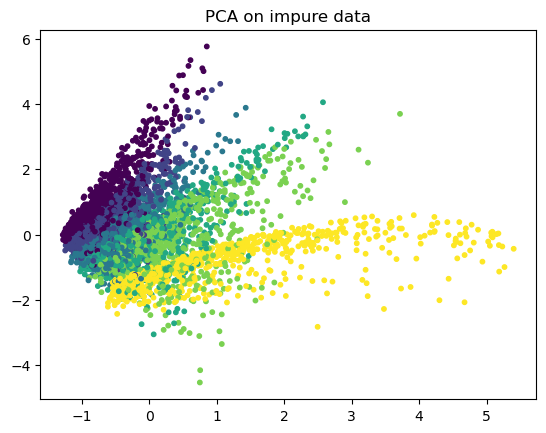

In [ ]:
plt.scatter(pca_transformed_impure[:,0],pca_transformed_impure[:,1], s=10, c=y_test)
plt.title("PCA on impure data")
plt.show()

In [ ]:
df_imp = pd.DataFrame()
data_impure = umap3d_transformed_impure
df_imp["x"] = data_impure[:,0]
df_imp["y"] = data_impure[:,1]
df_imp["z"] = data_impure[:,2]
df_imp["a"] =  np.around(cells_test[:,0], 2)
df_imp["b"] =  np.around(cells_test[:,1], 2)
df_imp["c"] =  np.around(cells_test[:,2], 2)
df_imp["al"] = np.around(np.degrees(cells_test[:,3]), 2)
df_imp["be"] = np.around(np.degrees(cells_test[:,4]), 2)
df_imp["ga"] = np.around(np.degrees(cells_test[:,5]), 2)
df_imp["volume"] = np.around(volumes_test,2)
df_imp["cs"] = y_test
csdict = {}
for i,x in enumerate(systems):
    csdict[i] = x
df_imp["crystal_system"] = df_imp["cs"].map(csdict)

In [ ]:
df["impure"] = np.zeros(df.shape[0])
df_imp["impure"] = np.ones(df_imp.shape[0])

In [ ]:
both = pd.concat([df, df_imp])
both["impure"] = both["impure"].map({0:"pure",1:"impure"})
both.describe()

,x,y,z,a,b,c,al,be,ga,volume,cs
count,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000
mean,1.367028,5.039832,4.860281,12.524706,12.509490,12.449264,91.679328,93.347108,96.636279,2041.791418,2.500000
std,4.420446,3.826195,5.524264,4.311997,4.307781,4.328477,5.994581,8.197659,12.012234,1543.642428,1.707854
min,-5.423842,-2.962592,-5.349432,5.000000,5.000000,5.000000,80.000000,80.010000,80.000000,79.070000,0.000000
25%,-2.237483,1.780744,0.271064,8.810000,8.817500,8.660000,90.000000,90.000000,90.000000,878.485000,1.000000
50%,1.405605,5.163531,4.262781,12.550000,12.510000,12.430000,90.000000,90.000000,90.000000,1614.475000,2.500000
75%,3.341424,7.185151,9.769769,16.240000,16.210000,16.180000,90.000000,90.000000,99.692500,2783.850000,4.000000
max,13.603477,14.783800,18.217787,20.000000,20.000000,20.000000,120.000000,120.000000,120.000000,7998.140000,5.000000


In [ ]:
fig = px.scatter_3d(both, x="x", y="y", z="z", color="crystal_system",symbol="impure",size="volume",size_max=20,opacity=1,hover_data=["a","b","c","al","be","ga","volume","crystal_system"])
fig.update_layout(margin=dict(l=0, r=0, b=0, t=0))
fig.show()


In [ ]:
impure_pred = clf.predict(impure_patterns)

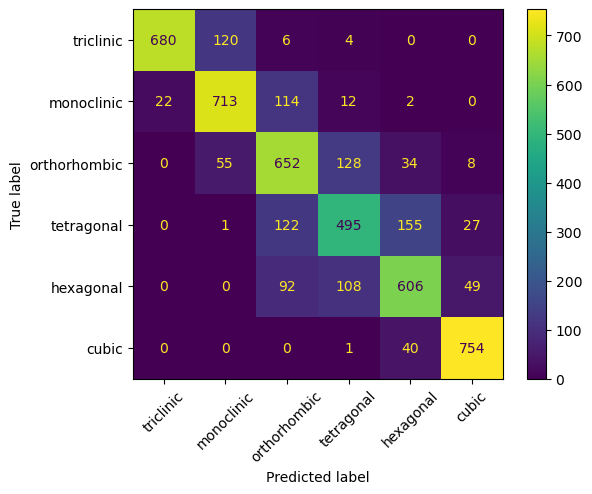

In [ ]:
cm = confusion_matrix(y_test, impure_pred)
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=systems)
disp.plot()
plt.xticks(rotation=45)
plt.show()